Author: Ahmed Sobhi

Creation_date: 14th June 2023

Objective: Data cleaning.

## Importing Required libararies and packages

In [44]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
# Used for visulization
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()
sns.set_style("whitegrid")

# For iteration visulization purpose
from tqdm import tqdm

# dataprep for data report exploration
from dataprep.eda import create_report

# uses Levenshtein distance to calculate the differences between sequences and patterns
from fuzzywuzzy import fuzz

## Required Functions

In [75]:
def feature_normalized_extract(col:pd.Series, threshold:int=90)-> list:
    """
        Used to extract the normalized features in a list format.
        by setting a threshold, calculating Levenshtein distance to detect the differences between sequences and patterns.

        Input:
            col: pandas Series, describe a column of strings features. 

        Output:
            list, describe the normalized feature list generated.
    """
    # Normalize the strings
    normalized_strings = []

    for string in col.unique():
        found = False
        for i, normalized_string in enumerate(normalized_strings):
            if fuzz.partial_ratio(string, normalized_string) >= threshold:
                normalized_strings[i] = normalized_string
                found = True
                break
        if not found:
            normalized_strings.append(string)

    return normalized_strings


def feature_normalized_assign(_df:pd.DataFrame, col:str, normalized_features:list)->pd.DataFrame:
    """
        Used to replace feature with normalized one.

        Input:
            _df: pandas DataFrame, describe the input dataframe.
            col: string, descirbe the column name to assign values into.
            normalized_features: list, describe the normalized features.

        Output:
            pandas DataFrame with created features normalized column.
    """
    # Create a copy of datafrae
    df_copy = _df.copy()

    assigned_feaures = []

    for feature in tqdm(df_copy[col].values, total=df_copy.shape[0]):
        found = False
        for normalized_feature in normalized_features:
            if normalized_feature in feature:
                assigned_feaures.append(normalized_feature)
                found = True
                #print('found', feature, normalized_feature)
                break
        if not found:
            assigned_feaures.append(feature)

    df_copy['feature_norm'] = assigned_feaures
    
    return df_copy


def plot_timeseries_trend(df:pd.DataFrame, timestamp_col:str, target_col:str, groupby_lst:list, fig_title:str='', save:bool=False)->None:
    """
        Plot price trend per input selected feature

        Input:
            df: pandas DataFrame, input dataset.
            timestamp_col: str, timestamp feature which will be x-axis.
            target_col: str, target featuers, which will be y-axis
            groupby_col: list, features which the dataset will be grouped by.
            fig_title: str, title of the plot
            save: boolean, indicate whether save or not to save the plot.

        Output:
            None.
    """

    # Create a copy of input dataframe
    _df = df.copy()

    # Group the data by category
    grouped_data = _df.sort_values(timestamp_col, ascending=True).groupby(groupby_lst)

    # Determine the number of categories
    num_categories = len(grouped_data)

    # Calculate the number of rows and columns for subplots
    num_rows = int(num_categories / 2) + num_categories % 2
    num_cols = 2

    # Create subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))

    # Flatten the axes array to easily iterate through subplots
    axes = axes.flatten()

    # Plotting the trend for each category
    for i, (category, group) in enumerate(grouped_data):
        ax = axes[i]  # Select the appropriate subplot
        ax.plot(group[timestamp_col], group[target_col])
        ax.set_title(category)
        ax.set_xlabel('Time')
        ax.set_ylabel(target_col)

    # Hide empty subplots if necessary
    if num_categories < num_rows * num_cols:
        for j in range(num_categories, num_rows * num_cols):
            fig.delaxes(axes[j])
    
    plt.suptitle(fig_title)
    plt.tight_layout()  # Adjust the spacing between subplots
    
    if save==True:
        plt.savefig(f'../report/plots/{fig_title.replace(" ", "_")}.jpg')
    
    plt.show()

    return None


def remove_outlier_iqr(df:pd.DataFrame, target_col:str)->pd.DataFrame:
    """
        Used to remove outliers using IQR

        Input:
            df: pandas DataFrame, describe input dataframe which require outliers removal
            target_col: str, describe the target column which we need to remove outlier from.

        Output:
            Pandas DataFrame, after removing outliers
    """

    # Create a copy of input dataframe
    _df = df.copy()

    # Calculate 1st & 3re quanttile
    q1, q3 = _df[target_col].quantile(0.25), _df[target_col].quantile(0.75)

    # Caluclate IQR
    iqr = q3 - q1

    # Return filtered dataframe
    return _df[_df[target_col].between(q1 - iqr*1.5, q3 + iqr*1.5, inclusive='both')] 

def remove_outlier_by_features(_df:pd.DataFrame, features_lst:list, target_col:str)->pd.DataFrame:
    """
        Used to remove outliers based on input selected features in the dataframe.
        Outlier removal method is IQR

        Input:
            df: pandas DataFrame, describe input dataframe which require outliers removal
            features_lst: list, describe the input columns features list.
            target_col: str, describe the target column which we need to remove outlier from.

        Output:
            Pandas DataFrame, after removing outliers
    """

    # Make a copy of input dataframe
    df_copy = _df.copy()

    # Create empty list for records storing, to be converted into dataframe later.
    Q1 = df_copy.groupby(features_lst)[target_col].transform('quantile', 0.25)
    Q3 = df_copy.groupby(features_lst)[target_col].transform('quantile', 0.75)

    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR

    upper_bound = Q3 + 1.5 * IQR

    return df_copy[df_copy[target_col].between(lower_bound, upper_bound, inclusive='both')]

## Loading Dataset

In [46]:
# Loading dataset
df = (
    pd.read_csv('../data/raw/DS-task-data.csv')
    .assign(
        priced_at= lambda x: pd.to_datetime(x.priced_at)
    )
    .rename(columns={'year':'model_year'})
)

# Sort values based on price_at
df = df.sort_values(['model', 'model_year', 'priced_at'])

# Creating an id index for each record
# Extracting features with its id in another dataframe
df = df.reset_index(names='id')

# Display first 5 rows
df.head()

,id,make,model,model_year,kilometers,transmission_type,extra_features,price,priced_at
0,17786,Nissan,Juke,2008,200000.0,Automatic,NaN,115000,2022-02-11
1,9997,Nissan,Juke,2008,200000.0,Automatic,NaN,116000,2022-04-21
2,8738,Nissan,Juke,2009,19999.0,Automatic,NaN,239000,2022-06-01
3,9477,Nissan,Juke,2010,115000.0,Automatic,NaN,195000,2022-02-07
4,12801,Nissan,Juke,2011,19279.0,Automatic,Air Conditioning; Fabric brushes; Electric mir...,248000,2022-06-29


In [47]:
# Display dataframe info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20098 entries, 0 to 20097
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   id                 20098 non-null  int64         
 1   make               20098 non-null  object        
 2   model              20098 non-null  object        
 3   model_year         20098 non-null  int64         
 4   kilometers         19886 non-null  float64       
 5   transmission_type  20098 non-null  object        
 6   extra_features     12546 non-null  object        
 7   price              20098 non-null  int64         
 8   priced_at          20098 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(1), int64(3), object(4)
memory usage: 1.4+ MB


In [48]:
# display dataframe statics
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,20098.0,10048.500000,5801.937191,0.0,5024.25,10048.5,15072.75,20097.0
model_year,20098.0,2016.159469,4.865029,1918.0,2014.00,2017.0,2020.00,2024.0
kilometers,19886.0,97220.449764,143404.798854,0.0,41000.00,90000.0,139999.00,17200016.0
price,20098.0,274005.124888,242835.744300,0.0,176000.00,245000.0,336000.00,25895000.0


In [49]:
# Create a data report.
report = create_report(df)
# Store the report in html format
report.save('../report/reports/raw_data_report')

  0%|          | 0/1189 [00:00<?, ?it/s]

Report has been saved to ../report/reports/raw_data_report.html!


DataPrep Report
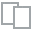
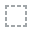
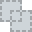
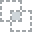
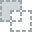
...
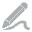
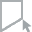
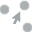
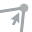
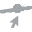

In [50]:
report

From the report:
- There are missing values in both features {kilometers, extra_features} which require handling.
- In model_year Feature is skewed, that because of older model years were included in the dataset. But this feature can be considered as outliers to remove, but we need to make sure there are sufficient records for each model_year to be able to predict them correctly and not having biasing in the model.
- There are skewness also in both {model_year: left skewness, price: right skewness}.
- Around 6.5% of data are Manual transmission_type, and the rest are Automatic transmission_type.

## Handling Missing Values

In [51]:
# Count percentage of missing values
print('Percentage of missing values per each feature:')
df.isna().sum()/df.shape[0]*100

Percentage of missing values per each feature:


id                    0.000000
make                  0.000000
model                 0.000000
model_year            0.000000
kilometers            1.054831
transmission_type     0.000000
extra_features       37.575878
price                 0.000000
priced_at             0.000000
dtype: float64

There are a small percentage of missing values in kilometers feature, so it could be solved by dropping the missing values.

But before that, we need to which car model these missing values belong.

Regarding 'extra_features' column, missing values will filled with empty string, which indicate this car does not have any features.
- Will be handled in Handling extra_features column.

In [52]:
# which car model has the highest number of percentage of missing kilometers feature?
print('Percentage of missing values per car model:')
df[df.kilometers.isna()]['model'].value_counts()/df.model.value_counts()*100

Percentage of missing values per car model:


Juke              0.715137
Juke Platinium         NaN
Qashqai           0.875716
Sentra            0.883576
Sunny             1.145147
Tiida             0.765306
Name: model, dtype: float64

Each car model has a small percentage of missing values, so we could simply remove them from our dataset.

In [53]:
# Drop missing values in kilometer feature
df = df.dropna(subset='kilometers', axis=0)

## Handling model_year Feature

In [54]:
df.model_year.describe()

count    19886.000000
mean      2016.135774
std          4.863836
min       1918.000000
25%       2014.000000
50%       2017.000000
75%       2020.000000
max       2024.000000
Name: model_year, dtype: float64

In [55]:
df[df.model_year<=2005]['model_year'].value_counts().sort_index()

1918     1
1980     1
1982     1
1983     1
1984     6
1985     5
1986     3
1988     1
1989     1
1990     8
1991     5
1992     2
1993     3
1994    27
1995    38
1996    12
1997    23
1998    20
1999    91
2000    83
2001    63
2002    53
2003    60
2004    29
2005    65
Name: model_year, dtype: int64

There are some model_year with low numbers of records.

Based on our project target to estimate the used cars prices, it is advisable to consider removing records for model_year with low number of instaces.

Here is some rationale behind this recommendation:
- Data Representativeness: Estimating prices requires a robust and representative dataset, so having only few records may not provide enough information to accurately estimate prices for that particular model year.
- Reliable Predictions: Machine learning models and statistical models require a sufficient number of data points to make reliable prediction.
- Avoiding Biased Estimates: Including small records for certain model year may introduce bias in your price estimation.

So model years with less than 10 records will be considered outliers and will be removed

In [56]:
# remove model_years with less than 10 records
df['model_year'].value_counts().describe()

count      44.000000
mean      451.954545
std       670.030057
min         1.000000
25%         5.000000
50%        61.500000
75%       533.750000
max      1936.000000
Name: model_year, dtype: float64

In [57]:
# Define a threshold for minimum number of records to have for each model_year feature.
model_year_threshold = 50 

# Calculate the value counts per model_year
model_year_value_counts = df.model_year.value_counts()

# Filter out only the model_year for years below that threshold
model_years_below_thr_index = model_year_value_counts[model_year_value_counts <= model_year_threshold].index

# filter dataframe
df = df[~df.model_year.isin(model_years_below_thr_index)]

# display the status for modified model_year
df.model_year.describe()

count    19697.000000
mean      2016.335279
std          4.365032
min       1999.000000
25%       2014.000000
50%       2017.000000
75%       2020.000000
max       2023.000000
Name: model_year, dtype: float64

## Handling Kilometer feature
- Quantify ranges for kilometers Using Binning approach

In [58]:
df.kilometers.describe().T

count    1.969700e+04
mean     9.683956e+04
std      1.437566e+05
min      0.000000e+00
25%      4.100000e+04
50%      9.000000e+04
75%      1.399990e+05
max      1.720002e+07
Name: kilometers, dtype: float64

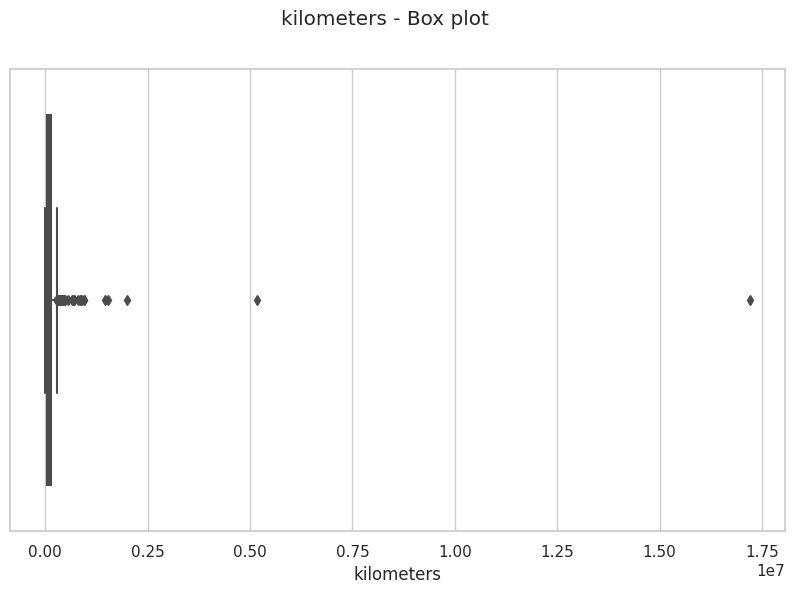

In [60]:
# Plot boxplot
plt.figure(figsize=(10, 6))  # Set the desired figure size

sns.boxplot(x='kilometers', data=df)

plt.suptitle('kilometers - Box plot')

# Save figure
plt.savefig('../report/plots/boxplot_kilometers.jpg')

plt.show()

In [61]:
# Remove outliers from kilometers data
df = remove_outlier_iqr(df, 'kilometers')

In [62]:
# Define bin thresholds
bin_thresholds = [0, 50000, 100000, 150000, 200000, float('inf')]

# Define bin label
bin_labels = ['0-50k', '50k-100k', '100k-150k', '150k-200k', '200k+']

# Create a new column named "mileage_category" with the bin labels
df['mileage_category'] = pd.cut(
    df['kilometers'],
    bins=bin_thresholds,
    labels=bin_labels,
    right=False
)

df.head()

,id,make,model,model_year,kilometers,transmission_type,extra_features,price,priced_at,mileage_category
0,17786,Nissan,Juke,2008,200000.0,Automatic,<NA>,115000,2022-02-11,200k+
1,9997,Nissan,Juke,2008,200000.0,Automatic,<NA>,116000,2022-04-21,200k+
2,8738,Nissan,Juke,2009,19999.0,Automatic,<NA>,239000,2022-06-01,0-50k
3,9477,Nissan,Juke,2010,115000.0,Automatic,<NA>,195000,2022-02-07,100k-150k
4,12801,Nissan,Juke,2011,19279.0,Automatic,Air Conditioning; Fabric brushes; Electric mir...,248000,2022-06-29,0-50k


In [63]:
# how many mileage_category
print(f'percentage of each category:\n{df.mileage_category.value_counts(normalize=True)*100}')   

percentage of each category:
50k-100k     29.480506
0-50k        28.633395
100k-150k    21.494182
150k-200k    15.171464
200k+         5.220453
Name: mileage_category, dtype: float64


### Ploting percentage of mileage_category vs each car model

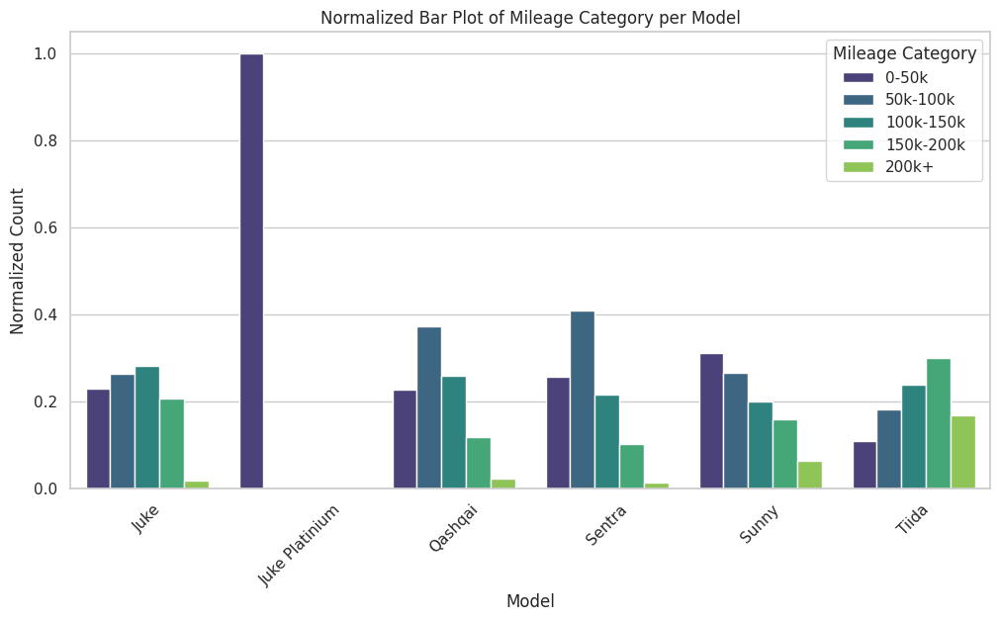

In [65]:
# Calculate the normalized value counts
normalized_counts = df.groupby('model')['mileage_category'].value_counts(normalize=True)

# Convert the normalized counts to a DataFrame
normalized_df = normalized_counts.rename('normalized_count').reset_index()

# Plot the bar plot with normalized y-axis
plt.figure(figsize=(12, 6))
sns.barplot(data=normalized_df, x='model', y='normalized_count', hue='mileage_category', palette='viridis')
plt.xlabel('Model')
plt.ylabel('Normalized Count')
plt.title('Normalized Bar Plot of Mileage Category per Model')
plt.xticks(rotation=45)
plt.legend(title='Mileage Category')
plt.savefig('../report/plots/mileage_category_barplot.jpg')
plt.show()

Juke Platinium has only 2 cars, which are already in 0-50k category.

## Handling extra_features column
- There are lots of missing value in extra_features column, So we have two options to solve that:
    - 1. Fill nan values with 'Not Available' label to indicate we don't have such information for given car.
    - 2. Fill nan values with most frequent 'mode' extra_features value based on car {model, model_year, transmission_type}. 
        - If we go deep in features to calculate the mode, some of data will also be missing, so we could for now consider the model feature only.

In [21]:
# Select subset of dataset features
df_features = df[['id', 'model', 'extra_features']]

# Fill nan values in extra_features column with mode value based on each car model
df_features['extra_features'] = df_features.groupby(['model'])['extra_features'].apply(lambda x: x.fillna(x.mode().iloc[0]))

# Drop unnessessary columns
df_features = df_features.drop('model', axis=1)

# Features extraction into list
df_features['extra_features_lst'] = df_features.extra_features.str.split(';')

# Remove leading space from features in the list
df_features['extra_features_lst'] = df_features.apply(lambda row: [feature.lstrip().lower() for feature in row.extra_features_lst], axis=1)

# Drop unnessary column
df_features.drop('extra_features', axis=1, inplace=True)

# Display head
df_features.head()

,id,extra_features_lst
0,17786,"[abs, air conditioning, airbags, alarm/anti-th..."
1,9997,"[abs, air conditioning, airbags, alarm/anti-th..."
2,8738,"[abs, air conditioning, airbags, alarm/anti-th..."
3,9477,"[abs, air conditioning, airbags, alarm/anti-th..."
4,12801,"[air conditioning, fabric brushes, electric mi..."


In [22]:
df_features.shape

(19596, 2)

### Experiment, Analysis for features normalization, if there are duplicated features but with different keywords

In [23]:
# Most of the features are duplicated by similar keywords, so it is required to normalize them
df_features_norm_exp = (
    df_features[['id', 'extra_features_lst']]
    .explode('extra_features_lst')
    .rename(columns={'extra_features_lst':'feature'})
    .assign(
        # Strip first space in each feature
        feature= lambda x : x.feature.str.replace(" ", "")
    )
)

df_features_norm_exp.head()

,id,feature
0,17786,abs
0,17786,airconditioning
0,17786,airbags
0,17786,alarm/anti-theftsystem
0,17786,am/fmradio


In [24]:
threshold = 70
normalized_features = feature_normalized_extract(df_features_norm_exp.feature, threshold)

df_features_norm_exp = feature_normalized_assign(df_features_norm_exp,'feature', normalized_features)

print(f'Features unique un-normalized= {df_features_norm_exp.feature.nunique()}, Normalized= {df_features_norm_exp.feature_norm.nunique()}')

df_features_norm_exp.head()

100%|██████████| 257518/257518 [00:00<00:00, 1373831.12it/s]


Features unique un-normalized= 75, Normalized= 65


,id,feature,feature_norm
0,17786,abs,abs
0,17786,airconditioning,airconditioning
0,17786,airbags,airbags
0,17786,alarm/anti-theftsystem,alarm/anti-theftsystem
0,17786,am/fmradio,am/fmradio


Let's go deep into normalized features, and manually check if still some features not cleaned yet

Checking the replaced features

In [25]:
df_temp_different_norm = df_features_norm_exp[df_features_norm_exp.feature_norm != df_features_norm_exp.feature]

display(df_temp_different_norm.head())

print(f'Replaced Features: {df_temp_different_norm["feature"].unique()}')
print(f'Replaced With: {df_temp_different_norm["feature_norm"].unique()}')

,id,feature,feature_norm
4,12801,frontpowerwindows,powerwindows
4,12801,backpowerwindows,powerwindows
35,505,frontpowerwindows,powerwindows
35,505,backpowerwindows,powerwindows
37,524,frontpowerwindows,powerwindows


Replaced Features: ['frontpowerwindows' 'backpowerwindows' 'keylessstart/stop'
 'anti-lockbrakingsystem(abs)' 'airbagspassenger' 'sideairbags'
 'airbagsfordriver' 'rearparkingsensors' 'multimediatouchscreen'
 'panoramicsunroof']
Replaced With: ['powerwindows' 'keylessstart' 'abs' 'airbags' 'parkingsensors'
 'touchscreen' 'sunroof']


In [26]:
df_features_norm_exp.feature_norm.unique()

array(['abs', 'airconditioning', 'airbags', 'alarm/anti-theftsystem',
       'am/fmradio', 'auxaudioin', 'bluetoothsystem', 'cruisecontrol',
       'ebd', 'foglights', 'keylessstart', 'leatherseats',
       'navigationsystem', 'off-roadtyres', 'parkingsensors',
       'powerlocks', 'powermirrors', 'powerseats', 'powersteering',
       'powerwindows', 'premiumwheels/rims', 'rearviewcamera', 'roofrack',
       'sunroof', 'touchscreen', 'usbcharger', 'fabricbrushes',
       'electricmirrors', 'bluetooth', 'cassetteradio', 'alarm',
       'remotekeyless', 'aux', 'usbport', 'sideairbag', 'sensors',
       'driverairbag', 'passengerairbag', 'alloywheels', 'closingmirrors',
       'tintedglass', 'cdplayer', 'eps', 'foglight', 'centrallock',
       'multifunction', 'cdchanger', 'rearspoiler', 'dvdplayer',
       'frontsensors', 'rearsensors', 'electronicwindow',
       'analogeaircondition', 'usb', 'tractioncontrol',
       'intelligentparkingsystem', 'gps', 'anti-theftsystem',
       'rearcam

In [27]:
keyword_lst = [
    'touch',
    'windows',
    'roof',
    'sensor',
    'airbags',
    'keyless',
    'usb',
    'aux'
    ]
# Create an empty dictionary
feature_like_dict = {}

for keyword in keyword_lst:

    feature_like_dict[keyword] = []
    
    for feature in df_features_norm_exp.feature_norm.unique():
        if keyword in feature:
            feature_like_dict[keyword].append(feature)

feature_like_dict

{'touch': ['touchscreen', 'touchactivateddoorlock'],
 'windows': ['powerwindows'],
 'roof': ['roofrack', 'sunroof', 'panoramaroof'],
 'sensor': ['parkingsensors', 'sensors', 'frontsensors', 'rearsensors'],
 'airbags': ['airbags'],
 'keyless': ['keylessstart', 'remotekeyless'],
 'usb': ['usbcharger', 'usbport', 'usb'],
 'aux': ['auxaudioin', 'aux']}

In [28]:
#df_features_norm_exp[df_features_norm_exp.feature=='frontsensors']

There are still some features would be normalized more like:
- 'sunroof' -> [panoramaroof]
- 'sensors' -> ['parkingsensors', 'rearsensors', 'sensors', 'frontsensors']
- 'keyless' -> ['keylessstart', 'remotekeyless']
- 'usb' -> ['usbport', 'usbcharger']
- 'aux' -> 'auxaudioin'

In [29]:
# Normalizing only specific features using features_map
features_map = {
    'panoramaroof' : 'sunroof',
    'parkingsensors' : 'sensors',
    'rearsensors' : 'sensors',
    'fronsensors' : 'sensors',
    'keylessstart' : 'keyless',
    'remotekeyless' : 'keyless',
    'usbport' : 'usb',
    'usbcharger' : 'usb',
    'auxaudioin' : 'aux'
}

df_features_norm = (
    df_features[['id', 'extra_features_lst']]
    .explode('extra_features_lst')
    .rename(columns={'extra_features_lst':'feature'})
    .assign(
        # remove all whitespaces in each feature
        feature= lambda x : x.feature.str.replace(" ", "")
    )
)

# Extract normalized features list
threshold = 70
normalized_features = feature_normalized_extract(df_features_norm.feature, threshold)

df_features_norm = feature_normalized_assign(df_features_norm,'feature', normalized_features)

# Apply maping function to replace features
df_features_norm.loc[
    df_features_norm.feature_norm.isin(features_map.keys()),
     'feature_norm'
     ] = (
        df_features_norm.loc[
            df_features_norm.feature_norm.isin(features_map.keys()),
             'feature_norm'
             ].map(features_map)
     )

# Store list of features to be used later
extra_features = df_features_norm.feature_norm.unique().tolist()

print(f'Number of unique features in all cars: {df_features_norm.feature_norm.nunique()}')

# Reconstruct the df_features dataframe again with normalized features
df_features_norm = (
        df_features_norm
        .groupby('id', as_index=False)
        .agg(
                extra_features_lst = ('feature_norm', pd.unique)
            )
)

# Create a feature, that represent the number of features per car id
df_features_norm['extra_features_count'] = df_features_norm.extra_features_lst.apply(lambda x: len(x))

df_features_norm.head()

100%|██████████| 257518/257518 [00:00<00:00, 1369723.01it/s]


Number of unique features in all cars: 58


,id,extra_features_lst,extra_features_count
0,0,"[aux, abs, analogeaircondition, powermirrors, ...",6
1,1,"[abs, airconditioning, airbags, alarm/anti-the...",8
2,2,"[aux, abs, analogeaircondition, powermirrors, ...",6
3,3,"[abs, airconditioning, am/fmradio, aux, blueto...",19
4,4,"[abs, airconditioning, airbags, alarm/anti-the...",15


In [30]:
# Apply one-hot encoding
df_encoded = pd.get_dummies(df_features_norm['extra_features_lst'].explode().replace('NaN', pd.NA), prefix='', prefix_sep='')

# Concatenate the encoded columns with the ID column
df_features_ohe = pd.concat([df_features_norm, df_encoded.groupby(level=0).sum()], axis=1)

df_features_ohe.head()

,id,extra_features_lst,extra_features_count,abs,airbags,airconditioning,alarm,alarm/anti-theftsystem,alloywheels,am/fmradio,...,sensors,sideairbag,startengine,steptronic,sunroof,tintedglass,touchactivateddoorlock,touchscreen,tractioncontrol,usb
0,0,"[aux, abs, analogeaircondition, powermirrors, ...",6,1,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,"[abs, airconditioning, airbags, alarm/anti-the...",8,1,1,1,0,1,0,0,...,1,0,0,0,0,0,0,0,0,0
2,2,"[aux, abs, analogeaircondition, powermirrors, ...",6,1,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,"[abs, airconditioning, am/fmradio, aux, blueto...",19,1,0,1,0,0,0,1,...,1,0,0,0,0,0,0,1,0,1
4,4,"[abs, airconditioning, airbags, alarm/anti-the...",15,1,1,1,0,1,0,1,...,0,0,0,0,0,0,0,0,0,1


In [31]:
# store feature-ohe dataframe into csv file format
df_features_ohe.to_csv('../data/intermid/features_ohe.csv', index=False)

## Handling Price Feature

We need to remove outliers from price feature, but we should take into consideration the other related features while removing the outliers.

In [66]:
df_stage_2 = df.drop('extra_features', axis=1).copy()

# Adding number of feature count
df_stage_2 = (
    df_stage_2.merge(
    df_features_ohe[['id', 'extra_features_count']],
    how='left',
    on='id'
    ).fillna(value=0)
)

df_stage_2.describe().T

,count,mean,std,min,25%,50%,75%,max
id,19596.0,10048.620433,5802.036618,0.0,5030.75,10051.5,15061.25,20097.0
model_year,19596.0,2016.365687,4.335611,1999.0,2014.00,2017.0,2020.00,2023.0
kilometers,19596.0,94040.663503,60040.698365,0.0,40000.00,89999.0,139999.00,285000.0
price,19596.0,275931.771790,241455.172962,0.0,178000.00,246000.0,337000.00,25895000.0
extra_features_count,19596.0,12.464074,7.807873,1.0,6.00,9.0,18.00,39.0


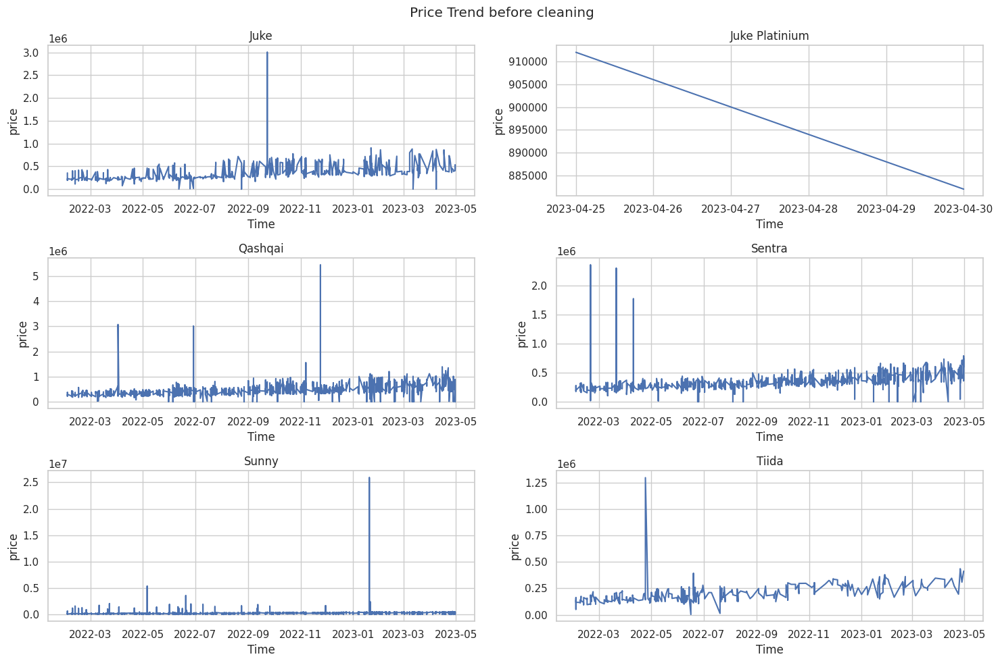

In [76]:
# Plot price timeseries trend over each car model
plot_timeseries_trend(df_stage_2, 'priced_at', 'price', ['model'], fig_title='Price Trend before cleaning', save=True)

There are trends in [Juke, Qashqai, Sentra, Tiida]

Model "Sunny" has almost constant trend, but we need to remove outliers to make sure of it.

To DO:

Outliers depend on model, year -> Use IQR

In [77]:
# How many data records for each model
df_stage_2.groupby('model')['id'].count()

model
Juke                830
Juke Platinium        2
Qashqai            2940
Sentra             1900
Sunny             13540
Tiida               384
Name: id, dtype: int64

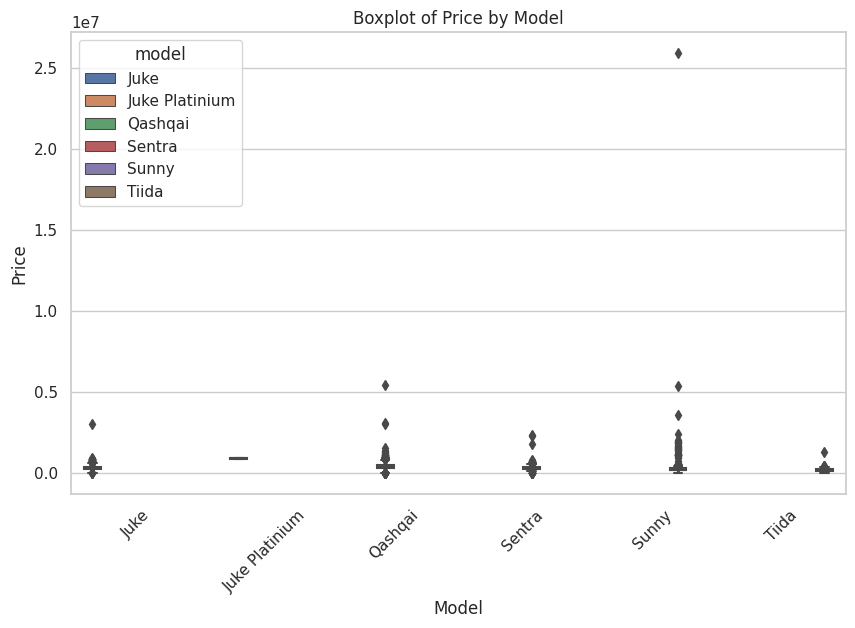

In [78]:
plt.figure(figsize=(10, 6))  # Set the desired figure size

sns.boxplot(x='model', y='price', data=df, hue='model')
plt.title('Boxplot of Price by Model')
plt.xlabel('Model')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.savefig('../report/plots/boxplot_price_before.jpg')
plt.show()

<Axes: xlabel='priced_at', ylabel='price'>

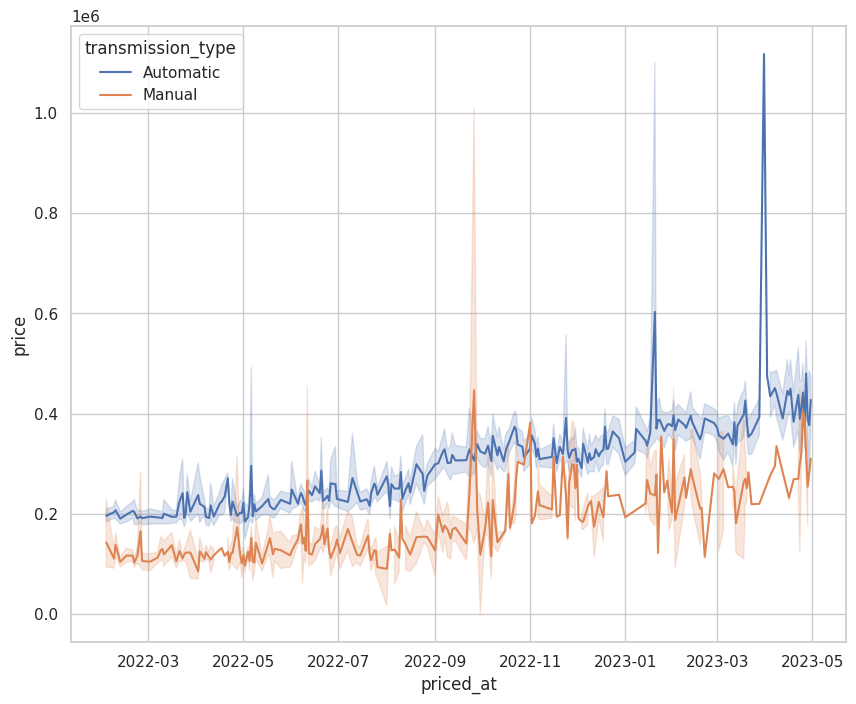

In [79]:
plt.figure(figsize=(10, 8))  # Set the desired figure size

# Does Transmission_type has effect on price?
fig = sns.lineplot(data=df_stage_2, x='priced_at', y='price', hue='transmission_type')

# Save figure
fig.get_figure().savefig('../report/plots/price_distribution_over_transmission_type.jpg')

fig

There is a different between price distribution over transmission_type, So we should include this feature during price outlier removal.

In [80]:
# Define some masks for removing outliers

# Define the corresponding half of year for each price date.
year_half_mask = (
    df_stage_2['priced_at']
    .dt.quarter.apply(lambda x: f"{x//2 + 1}H") 
    + ' ' 
    + df_stage_2['priced_at'].dt.year.astype(str)
)

# Define the corresponding year quarter for each price date
year_quarter_mask = df_stage_2['priced_at'].dt.to_period('Q')

# Define the corresponding month in year for each price date
year_month_mask = df_stage_2.priced_at.dt.strftime('%Y-%m')


In [81]:
# Remove outliters for price column
features_lst = ['model', 'model_year', 'transmission_type', year_half_mask]

target_col = 'price'

df_stage_2_filtered = remove_outlier_by_features(df_stage_2, features_lst, target_col)

# Number of filtered records
print(f"Removed records = {df_stage_2.shape[0] - df_stage_2_filtered.shape[0]}")

# display dataset status
display(df_stage_2_filtered.describe().T)

Removed records = 955


,count,mean,std,min,25%,50%,75%,max
id,18641.0,10036.755646,5800.797785,0.0,5033.0,10036.0,15034.0,20097.0
model_year,18641.0,2016.377501,4.321064,1999.0,2014.0,2017.0,2020.0,2023.0
kilometers,18641.0,94673.422456,59974.665626,0.0,43000.0,90000.0,139999.0,285000.0
price,18641.0,274339.091250,128450.028610,10000.0,181000.0,248000.0,337000.0,1384000.0
extra_features_count,18641.0,12.451585,7.790864,1.0,6.0,9.0,18.0,39.0


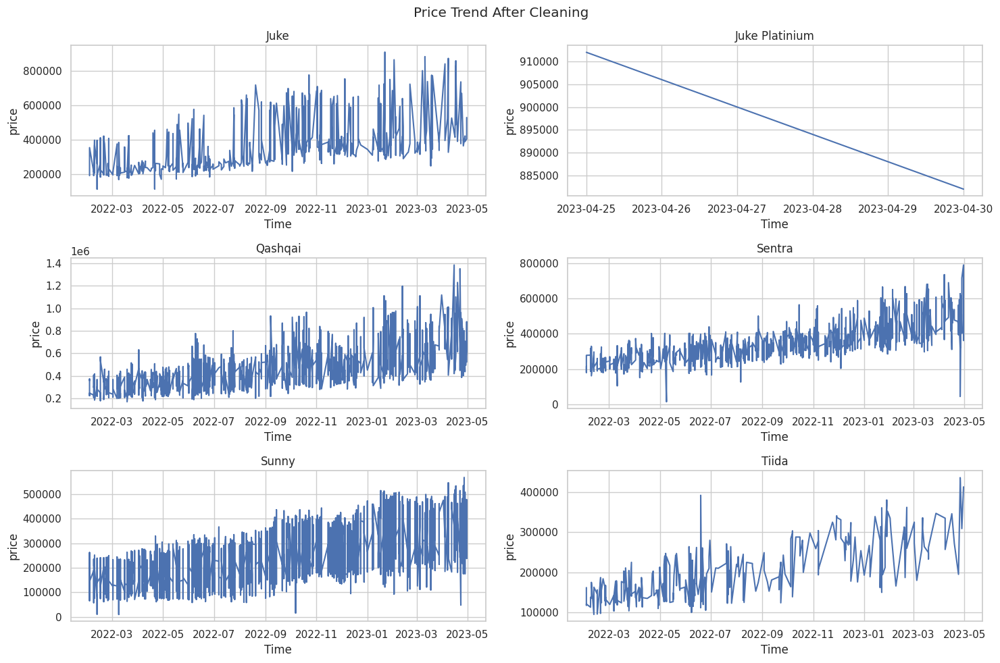

In [82]:
# Plot price timeseries trend over each car model
plot_timeseries_trend(df_stage_2_filtered, 'priced_at', 'price', ['model'], fig_title='Price Trend After Cleaning', save=True)

## Create a report for filtered data 

In [83]:
# Create a report for filtered data
report2 = create_report(df_stage_2_filtered)
report2.save('../report/reports/cleaned_data_report')

  0%|          | 0/1378 [00:00<?, ?it/s]

Report has been saved to ../report/reports/cleaned_data_report.html!


DataPrep Report
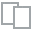
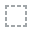
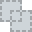
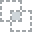
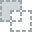
...
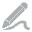
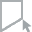
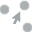
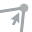
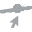

In [84]:
report2

## Save cleaned dataset locally

In [85]:
df_stage_2_filtered.to_csv('../data/intermid/DS-task-data-cleaned.csv', index=False)